## Imports

In [1]:
import h5py
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import pandas
from collections import Counter

/opt/conda/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


## Utilities

In [14]:
def convert(question):
    question = question[question != 0]
    return [vocab['question_idx_to_token'][w] for w in question[1:-1]]

def print_questions(questions, num=5):
    print("\n".join(" ".join(q) for q in questions[:num]))

## Load validation questions and computed gamma/betas

In [3]:
q_feats = h5py.File('data/q_types.h5', 'r')
film_data = h5py.File('data/clevr_film_params.h5', 'r')
vocab = utils.load_cpu('models/best.pt')['vocab']

## Gamma vs. Beta per channel coloured by Question Type

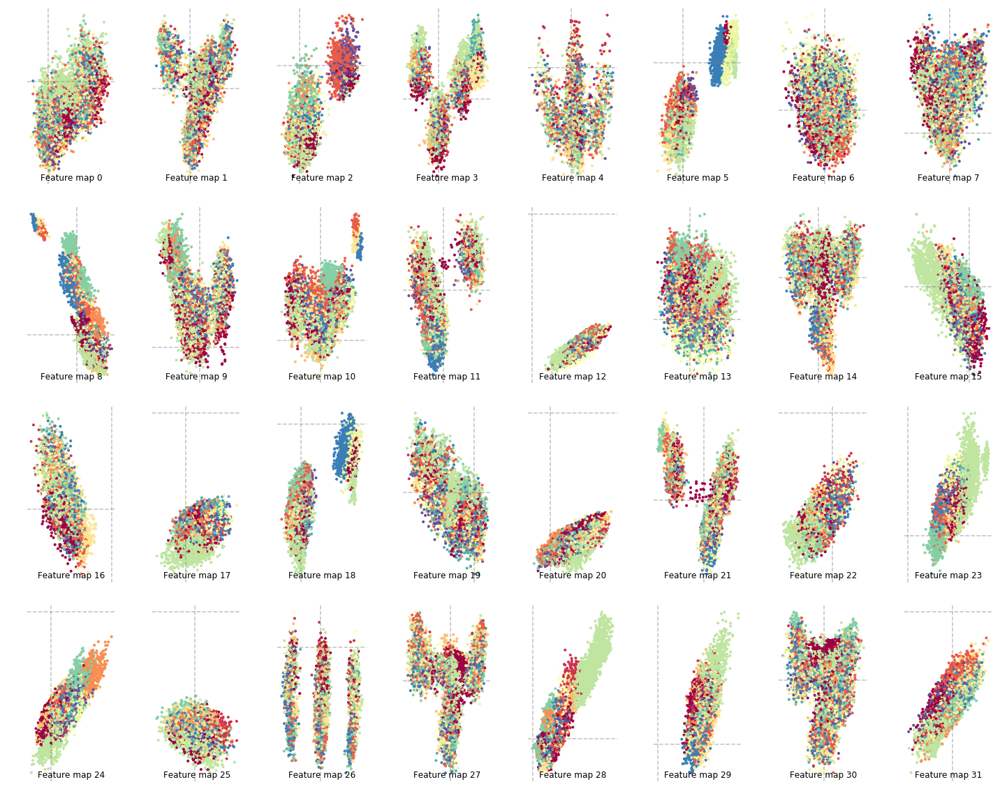

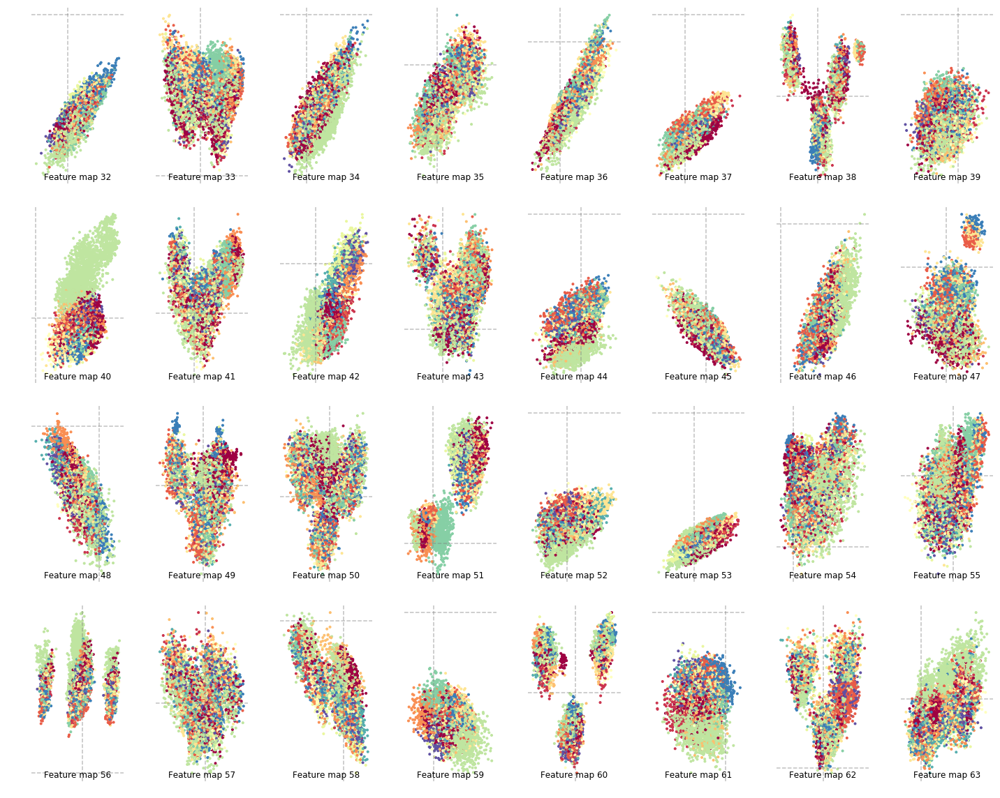

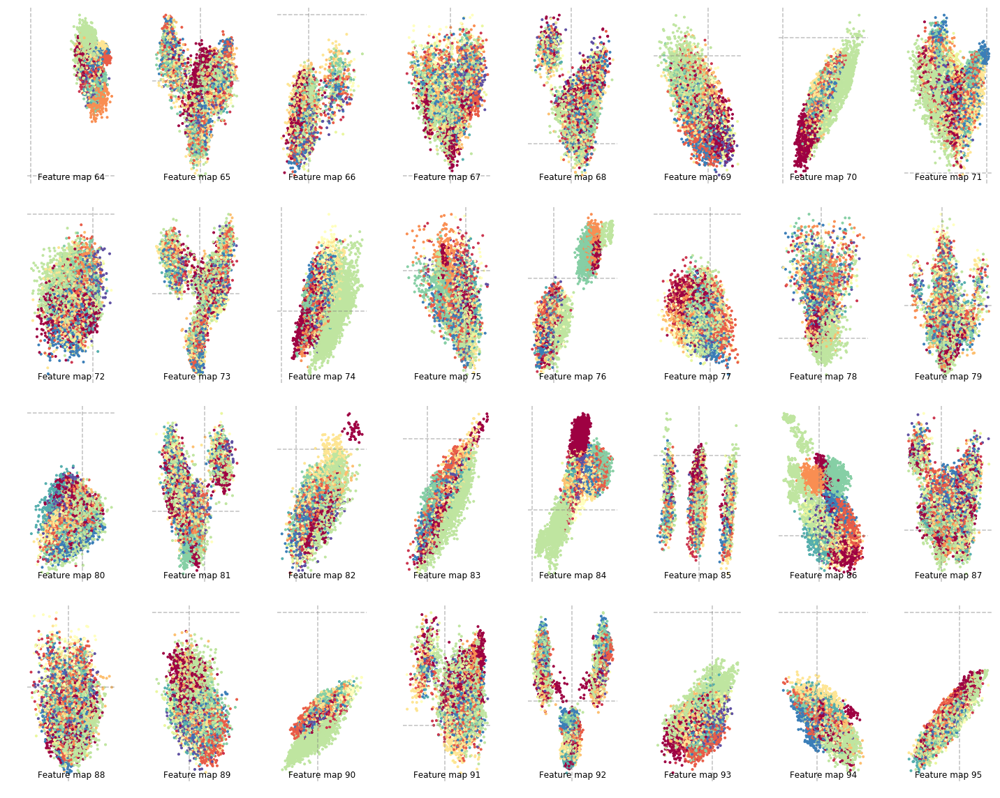

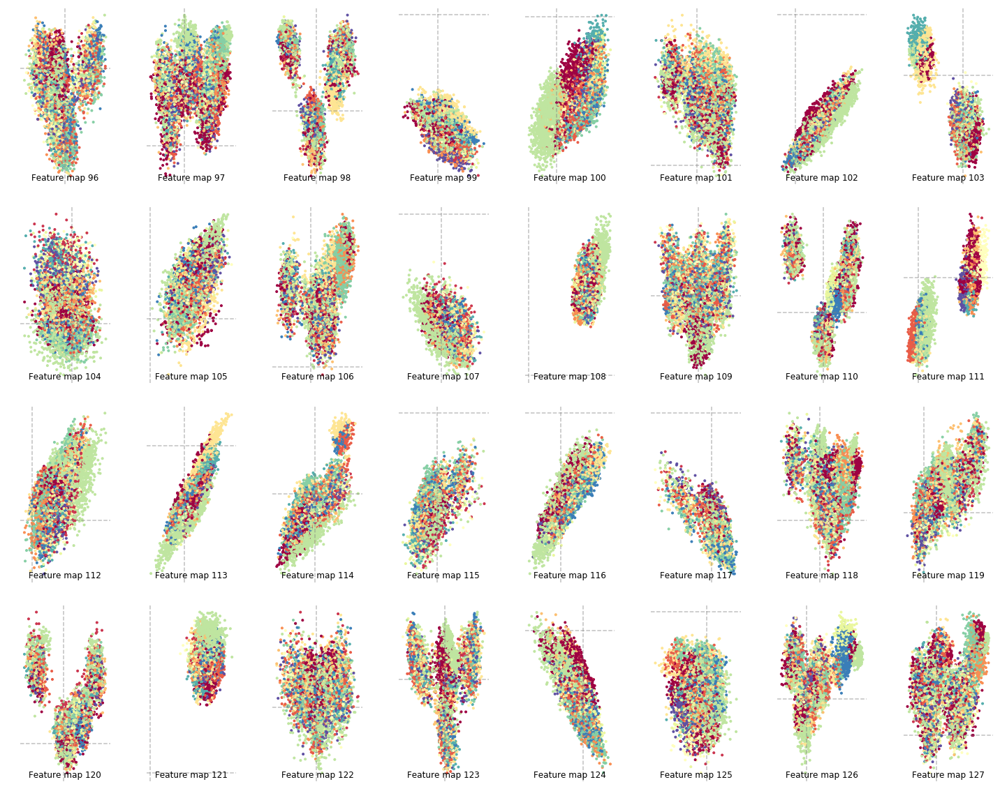

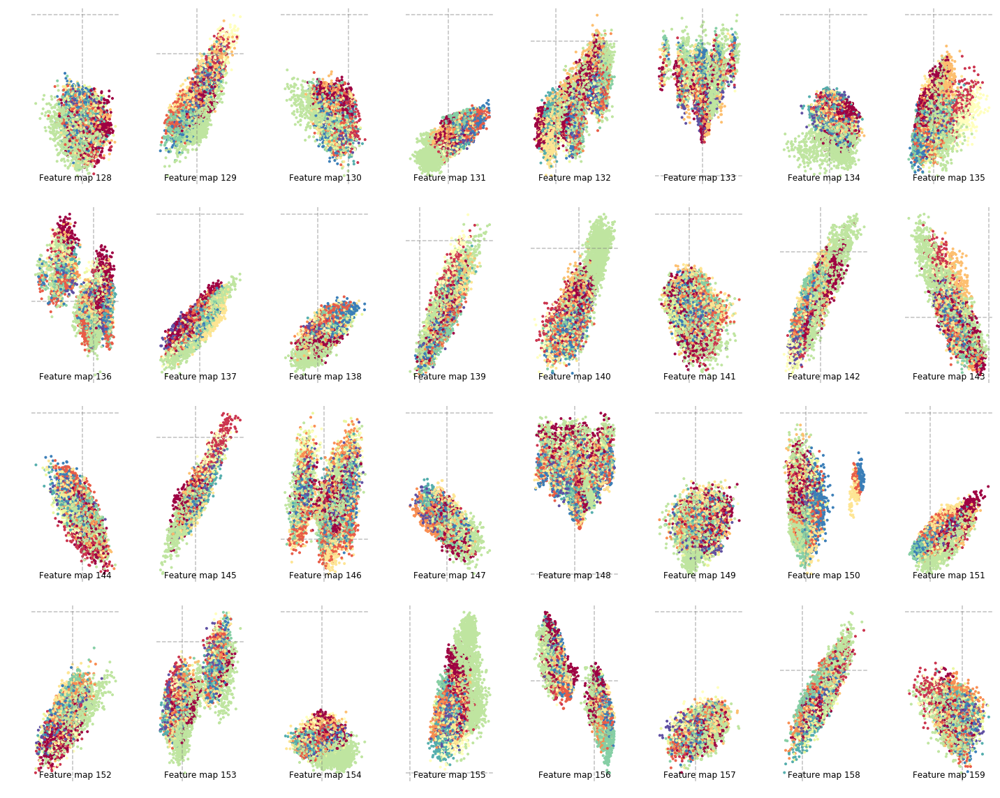

...

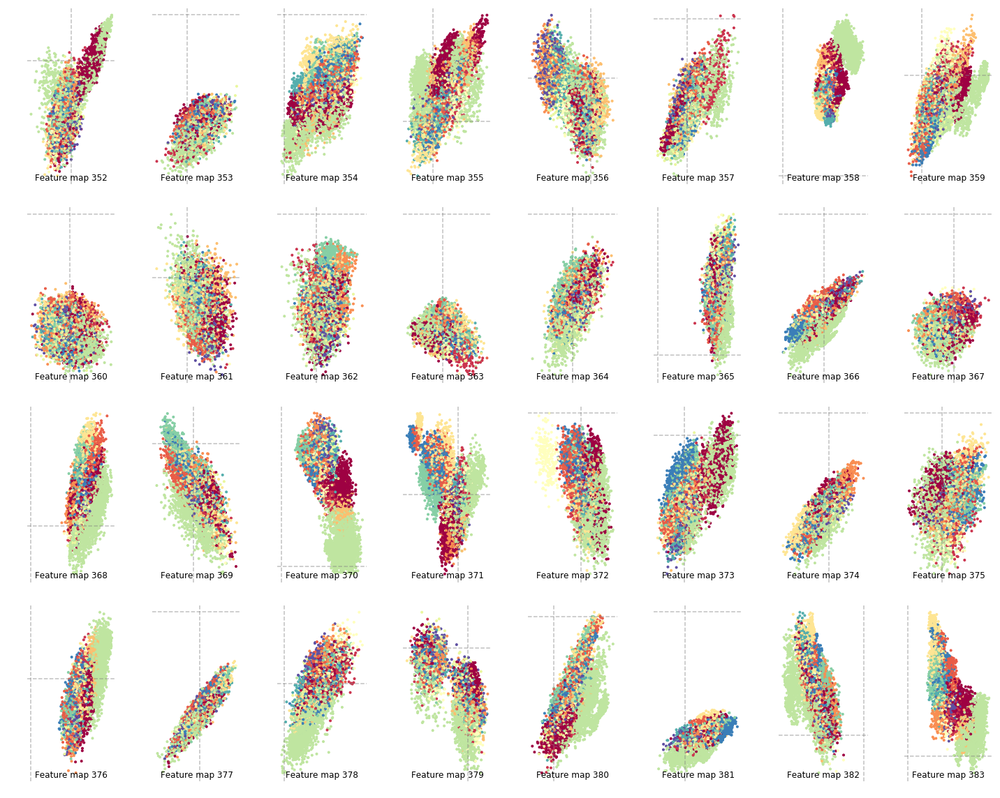

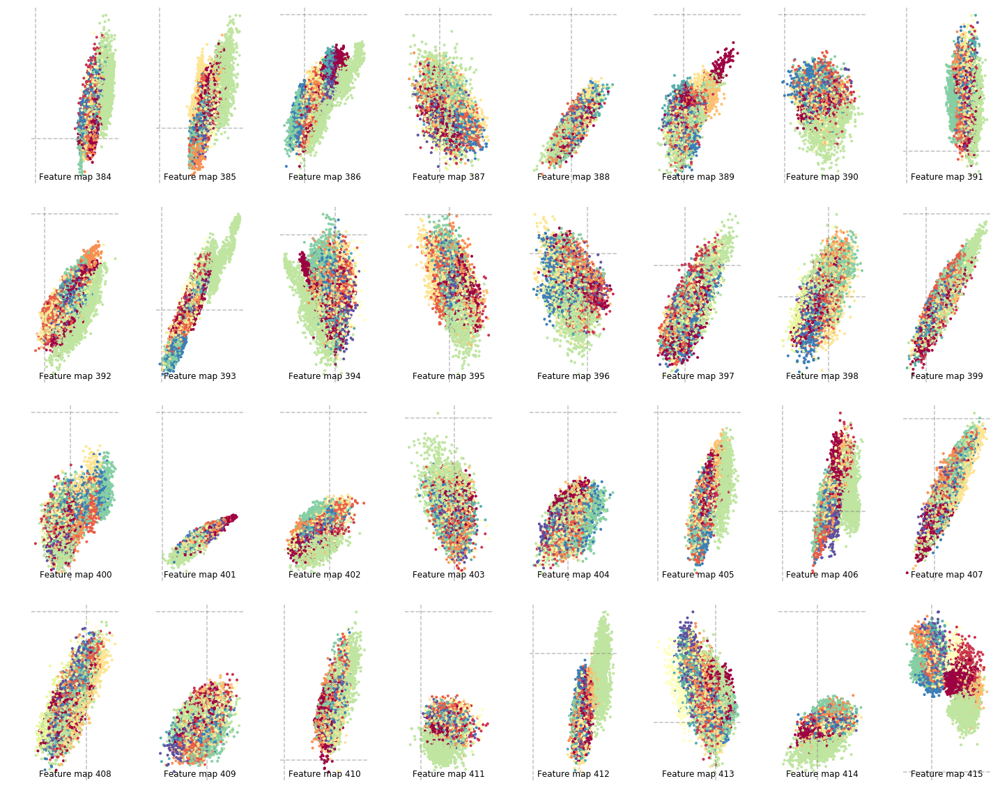

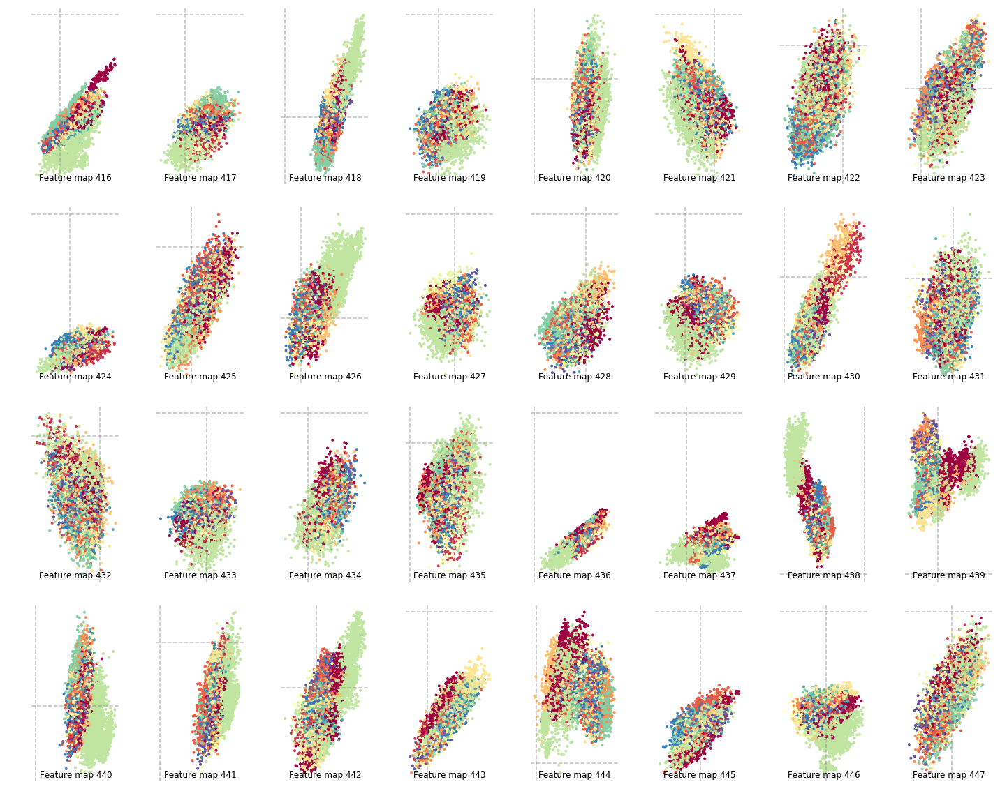

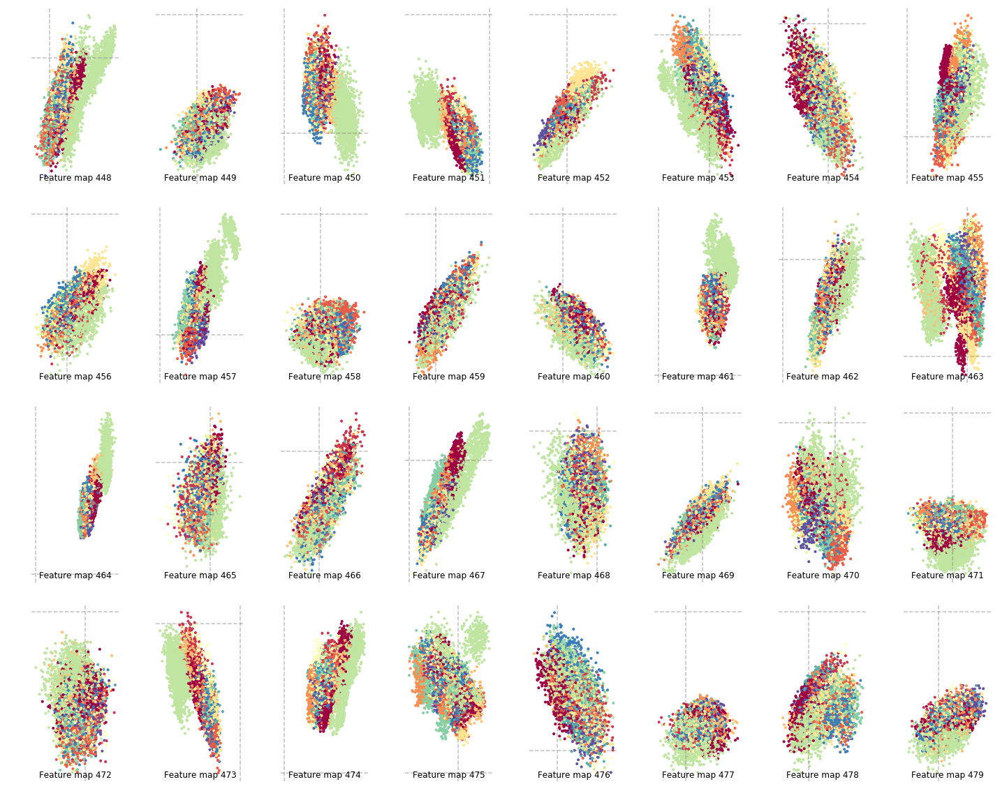

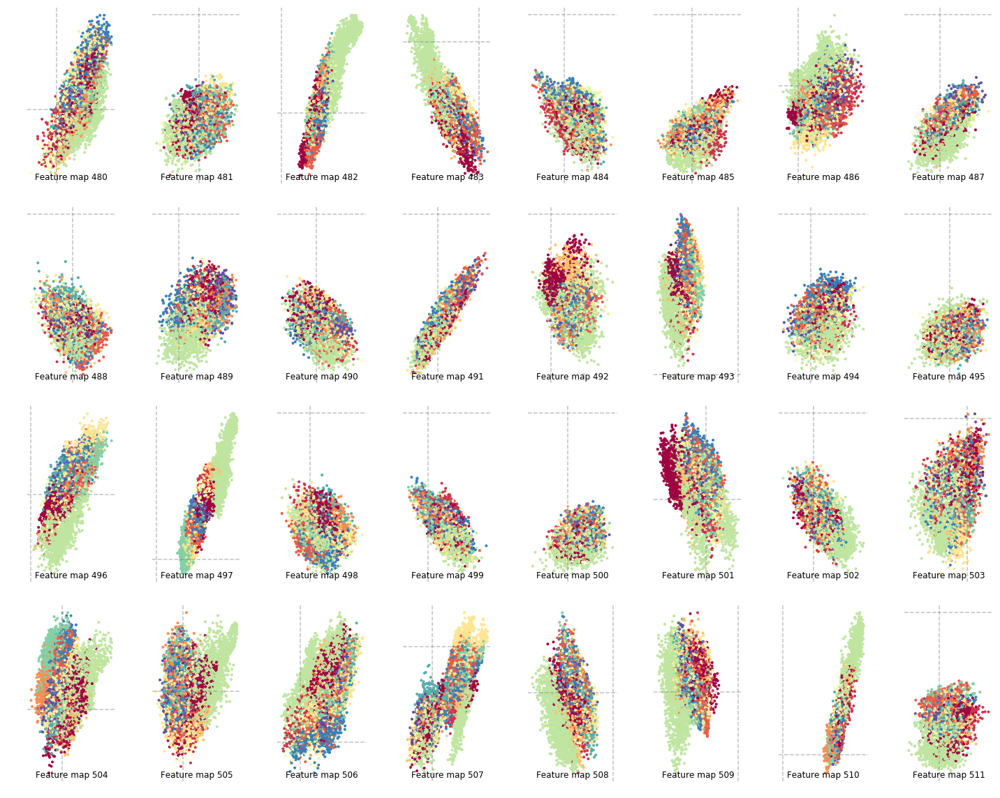

In [138]:
num_examples = 10000

gammas = film_data['gammas']
betas = film_data['betas']

c = np.tile(q_feats['types'][:num_examples], (512, 1)).T
for low in range(0, 512, 32):
    low, high = low, low + 32
    N = (high-low) // 32
    fig, axes = plt.subplots(4, 8, figsize=(20,16))
    
    for i, ax in enumerate(np.asarray(axes).ravel()):
        l = low + i * N
        h = low + (i + 1) * N
        ax.set_title(f'Feature map {low + i}')
        ax.title.set_position([.5, 0])
        ax.axis('off')
        ax.axhline(0, color='gray', linestyle="--", alpha=0.5)
        ax.axvline(0, color='gray', linestyle="--", alpha=0.5)

        scatter = ax.scatter(gammas[:, l:h], betas[:, l:h], c=c[:, l:h], marker='.', cmap='Spectral',
         norm=matplotlib.colors.Normalize(vmin=c[:, l:h].min(), vmax=c[:, l:h].max()))
    
    plt.tight_layout()
    plt.show()

### In Front / Behind Detector

In [84]:
from collections import Counter

def disagreeing_counters(c1, c2, delta=100): 
    for k, v in c1.items():
        if v > 100 and abs(c2[k] - v) > 100:
            print(k, abs(c2[k] - v))

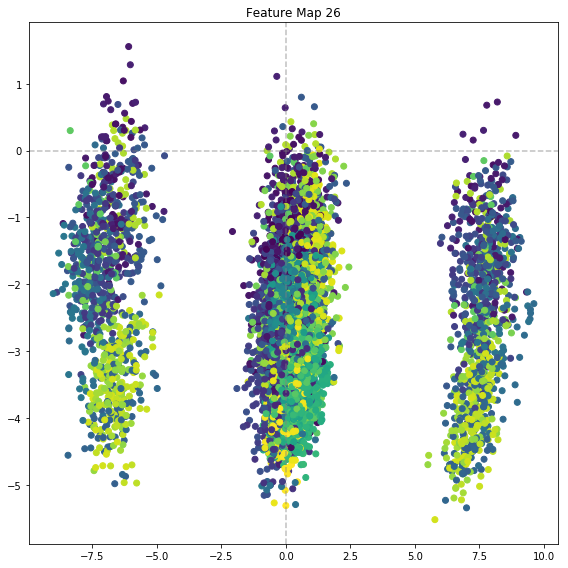

There are 969 examples in the left cluster and 957 in the right


NameError: name 'disagreeing_counters' is not defined

In [37]:
num_examples = 10000

gammas = film_data['gammas'][:num_examples]
betas = film_data['betas'][:num_examples]
c = np.tile(q_feats['question_families'][:num_examples], (512, 1)).T

fig, ax = plt.subplots(figsize=(8, 8))

idx = 26
l, h = idx, idx+1
ax.set_title(f'Feature Map {idx}')
ax.axhline(0, color='gray', linestyle="--", alpha=0.5)
ax.axvline(0, color='gray', linestyle="--", alpha=0.5)
x = gammas[:, l:h]
y = betas[:, l:h]
c = c[:, l:h]
ax.scatter(x, y, c=c)
plt.tight_layout()
plt.show()


left_cluster = gammas[:num_examples, idx] < -3
right_cluster = gammas[:num_examples, idx] > 3
print(f'There are {sum(left_cluster)} examples in the left cluster and {sum(right_cluster)} in the right')
l_q = [ convert(q) for q in q_feats['questions'][:num_examples][left_cluster] ]
r_q = [ convert(q) for q in q_feats['questions'][:num_examples][right_cluster] ]
l_c = Counter([w for q in l_q for w in q])
r_c = Counter([w for q in r_q for w in q])

disagreeing_counters(l_c, r_c)

In [94]:
### Left/Right Detector

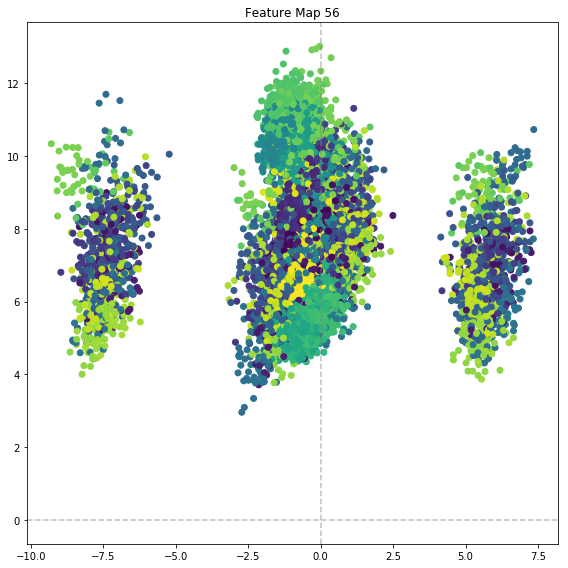

There are 941 examples in the left cluster and 957 in the right
thing 107
left 836
right 859


In [103]:
num_examples = 10000

gammas = film_data['gammas'][:num_examples]
betas = film_data['betas'][:num_examples]
c = np.tile(q_feats['question_families'][:num_examples], (512, 1)).T

fig, ax = plt.subplots(figsize=(8, 8))

idx = 56
l, h = idx, idx+1
ax.set_title(f'Feature Map {idx}')
ax.axhline(0, color='gray', linestyle="--", alpha=0.5)
ax.axvline(0, color='gray', linestyle="--", alpha=0.5)
x = gammas[:, l:h]
y = betas[:, l:h]
c = c[:, l:h]
ax.scatter(x, y, c=c)
plt.tight_layout()
plt.show()


left_cluster = gammas[:num_examples, idx] < -5
right_cluster = gammas[:num_examples, idx] > 3
print(f'There are {sum(left_cluster)} examples in the left cluster and {sum(right_cluster)} in the right')
l_q = [ convert(q) for q in q_feats['questions'][:num_examples][left_cluster] ]
r_q = [ convert(q) for q in q_feats['questions'][:num_examples][right_cluster] ]
l_c = Counter([w for q in l_q for w in q])
r_c = Counter([w for q in r_q for w in q])

disagreeing_counters(l_c, r_c)

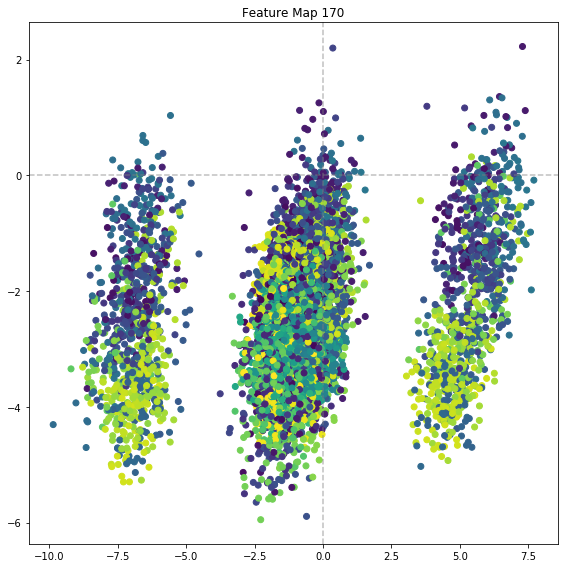

There are 938 examples in the left cluster and 957 in the right


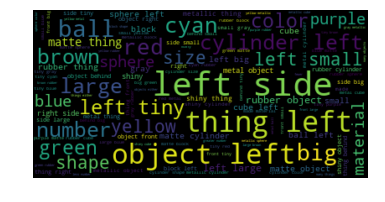

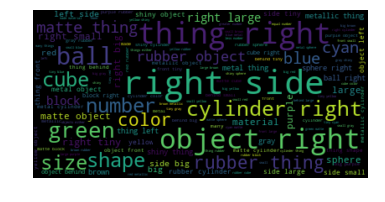

In [15]:
num_examples = 10000

gammas = film_data['gammas'][:num_examples]
betas = film_data['betas'][:num_examples]
c = np.tile(q_feats['question_families'][:num_examples], (512, 1)).T

fig, ax = plt.subplots(figsize=(8, 8))

idx = 170
l, h = idx, idx+1
ax.set_title(f'Feature Map {idx}')
ax.axhline(0, color='gray', linestyle="--", alpha=0.5)
ax.axvline(0, color='gray', linestyle="--", alpha=0.5)
x = gammas[:, l:h]
y = betas[:, l:h]
c = c[:, l:h]
ax.scatter(x, y, c=c)
plt.tight_layout()
plt.show()


left_cluster = gammas[:num_examples, idx] < -5
right_cluster = gammas[:num_examples, idx] > 2.5
print(f'There are {sum(left_cluster)} examples in the left cluster and {sum(right_cluster)} in the right')
l_q = [ convert(q) for q in q_feats['questions'][:num_examples][left_cluster] ]
r_q = [ convert(q) for q in q_feats['questions'][:num_examples][right_cluster] ]
l_c = Counter([w for q in l_q for w in q])
r_c = Counter([w for q in r_q for w in q])

def flatten_questions(question_list):
    return " ".join(" ".join(q) for q in question_list)

from wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(max_font_size=40).generate(flatten_questions(l_q))
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

wordcloud = WordCloud(max_font_size=40).generate(flatten_questions(r_q))
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

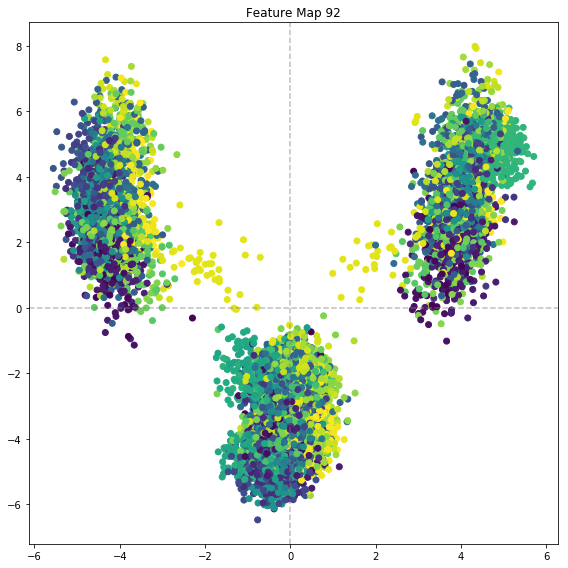

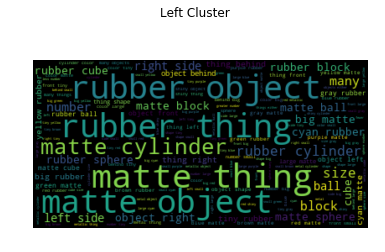

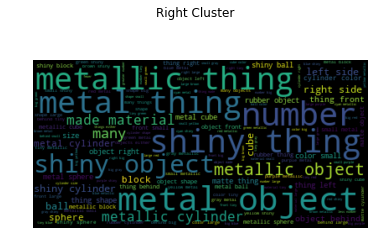

In [20]:
num_examples = 10000

gammas = film_data['gammas'][:num_examples]
betas = film_data['betas'][:num_examples]
c = np.tile(q_feats['question_families'][:num_examples], (512, 1)).T

fig, ax = plt.subplots(figsize=(8, 8))

idx = 92
l, h = idx, idx+1
ax.set_title(f'Feature Map {idx}')
ax.axhline(0, color='gray', linestyle="--", alpha=0.5)
ax.axvline(0, color='gray', linestyle="--", alpha=0.5)
x = gammas[:, l:h]
y = betas[:, l:h]
c = c[:, l:h]
ax.scatter(x, y, c=c)
plt.tight_layout()
plt.show()


left_cluster = gammas[:num_examples, idx] < -2
right_cluster = gammas[:num_examples, idx] > 2

l_q = [ convert(q) for q in q_feats['questions'][:num_examples][left_cluster] ]
r_q = [ convert(q) for q in q_feats['questions'][:num_examples][right_cluster] ]

def flatten_questions(question_list):
    return " ".join(" ".join(q) for q in question_list)

from wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(max_font_size=40).generate(flatten_questions(l_q))
plt.figure()
plt.suptitle("Left Cluster")
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()


wordcloud = WordCloud(max_font_size=40).generate(flatten_questions(r_q))
plt.figure()
plt.suptitle("Right Cluster")
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

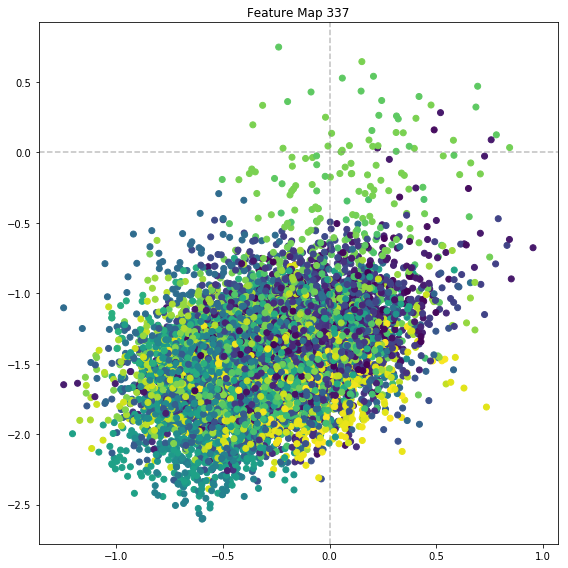

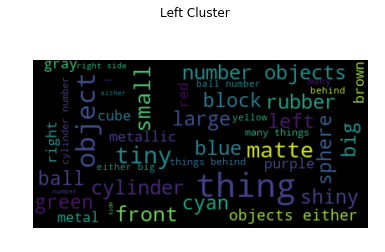

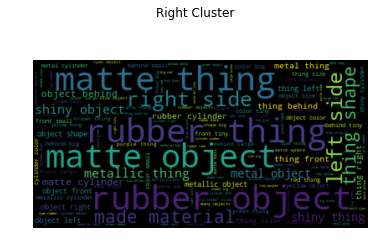

In [27]:
num_examples = 10000

gammas = film_data['gammas'][:num_examples]
betas = film_data['betas'][:num_examples]
c = np.tile(q_feats['question_families'][:num_examples], (512, 1)).T

fig, ax = plt.subplots(figsize=(8, 8))

idx = 337
l, h = idx, idx+1
ax.set_title(f'Feature Map {idx}')
ax.axhline(0, color='gray', linestyle="--", alpha=0.5)
ax.axvline(0, color='gray', linestyle="--", alpha=0.5)
x = gammas[:, l:h]
y = betas[:, l:h]
c = c[:, l:h]
ax.scatter(x, y, c=c)
plt.tight_layout()
plt.show()


left_cluster = betas[:num_examples, idx] > -0.3
right_cluster = betas[:num_examples, idx] < -0.3 

l_q = [ convert(q) for q in q_feats['questions'][:num_examples][left_cluster] ]
r_q = [ convert(q) for q in q_feats['questions'][:num_examples][right_cluster] ]

def flatten_questions(question_list):
    return " ".join(" ".join(q) for q in question_list)

from wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(max_font_size=40).generate(flatten_questions(l_q))
plt.figure()
plt.suptitle("Left Cluster")
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()


wordcloud = WordCloud(max_font_size=40).generate(flatten_questions(r_q))
plt.figure()
plt.suptitle("Right Cluster")
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [7]:
import plotly

plotly.tools.set_credentials_file(username='nschuc', api_key='EpNns7GVnuV5PLm3gb5Y')

In [29]:
import plotly.plotly as py
import plotly.graph_objs as go
import random
import numpy as np
import pandas as pd

num_examples = 1000

gammas = film_data['gammas'][:num_examples]
betas = film_data['betas'][:num_examples]

idx = 337
l, h = idx, idx+1
x = gammas[:, l:h]
y = betas[:, l:h]

questions = [ " ".join(convert(q)) for q in q_feats['questions'][:num_examples] ]

data = [
    go.Scatter(
        x=x,
        y=y,
        mode='markers',
        text=questions
    )
]

layout = go.Layout(
    title='Hover over the points to see the text'
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='hover-chart-basic')

High five! You successfully sent some data to your account on plotly. View your plot in your browser at https://plot.ly/~nschuc/0 or inside your plot.ly account where it is named 'hover-chart-basic'


In [32]:
[ vocab['program_idx_to_token'][t] for t in q_feats['programs'][0]]

['<START>',
 'exist',
 'same_shape',
 'unique',
 'filter_material[metal]',
 'filter_size[large]',
 'scene',
 '<END>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>',
 '<NULL>']

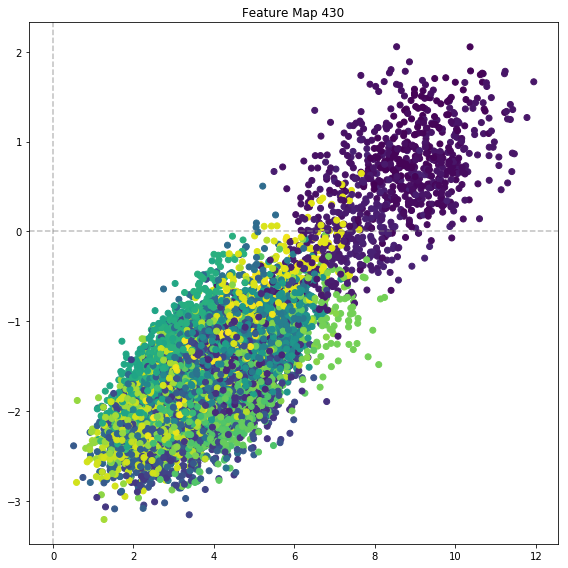

l <START> Are there more shiny things that are to the left of the yellow rubber thing than small red spheres <END>
<START> Is the number of brown cylinders in front of the brown matte cylinder less than the number of brown rubber cylinders <END>
<START> Are there an equal number of small things that are left of the gray object and large cyan matte balls <END>
<START> Are there more green objects than tiny rubber cylinders <END>
<START> Are there fewer tiny shiny cubes than green metallic things <END>


In [135]:
num_examples = 10000

gammas = film_data['gammas'][:num_examples]
betas = film_data['betas'][:num_examples]
c = np.tile(q_feats['question_families'][:num_examples], (512, 1)).T

fig, ax = plt.subplots(figsize=(8, 8))

idx = 430
l, h = idx, idx+1
ax.set_title(f'Feature Map {idx}')
ax.axhline(0, color='gray', linestyle="--", alpha=0.5)
ax.axvline(0, color='gray', linestyle="--", alpha=0.5)
x = gammas[:, l:h]
y = betas[:, l:h]
c = c[:, l:h]
ax.scatter(x, y, c=c)
plt.tight_layout()
plt.show()


cluster = betas[:num_examples, idx] > 0
questions = [ convert(q) for q in q_feats['questions'][:num_examples][cluster] ]
c = Counter([w for q in questions for w in q])

c.most_common()
print_questions(questions)

In [ ]:
import matplotlib.cm as cmx

num_examples = 1000

gammas = film_data['gammas'][:num_examples]
betas = film_data['betas'][:num_examples]

def words_in_question(question, words):
    return any([ vocab['question_idx_to_token'][w] in words for w in question ])
               
               
properties = {
    'materials': ['metallic', 'rubber', 'matte'],
    'colors': ['red', 'green', 'cyan', 'purple', 'gray', 'brown'],
    'shapes': ['cube', 'cylinder', 'sphere'],
}
categories = { k: k for k in properties['colors'] }

def question_to_category(question):
    num_in_category = [ words_in_question(question, words) for cat, words in categories.items() ]
    return np.argmax(num_in_category)

class_masks = np.asarray(
    [  [words_in_question(question, words) for question in q_feats['questions'][:num_examples]] for label, words in categories.items() ]
)

for low in range(0, 512, 32):
    low, high = low, low + 32
    N = (high-low) // 32
    fig, axes = plt.subplots(4, 8, figsize=(20,16))
    
    for i, ax in enumerate(np.asarray(axes).ravel()):
        l = low + i * N
        h = low + (i + 1) * N
        ax.set_title(f'Feature map {low + i}')
        ax.title.set_position([.5, 0])
        ax.axis('off')
        ax.axhline(0, color='gray', linestyle="--", alpha=0.5)
        ax.axvline(0, color='gray', linestyle="--", alpha=0.5)
        x = gammas[:, l:h].squeeze()
        y = betas[:, l:h].squeeze()
        for i, label in enumerate(categories):
            xi = x[class_masks[i]]
            yi = y[class_masks[i]]
            ax.scatter(xi, yi, label=label)
        ax.legend()
    plt.tight_layout()
    plt.show()


In [136]:
q_feats['questions'][0]

array([ 1,  6, 85, 18, 69, 87, 83, 20, 84, 74, 75, 21, 84, 25, 61, 64,  2,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0], dtype=int32)

In [40]:
import pickle
with open('data/vocab.pkl', 'wb') as f:
    pickle.dump(vocab, f)